In [11]:
import rasterio
from rasterio.plot import show
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyproj import Transformer, CRS
import pickle
from plotting.imagery import plot_landsat
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
import geopandas as gpd
import tqdm

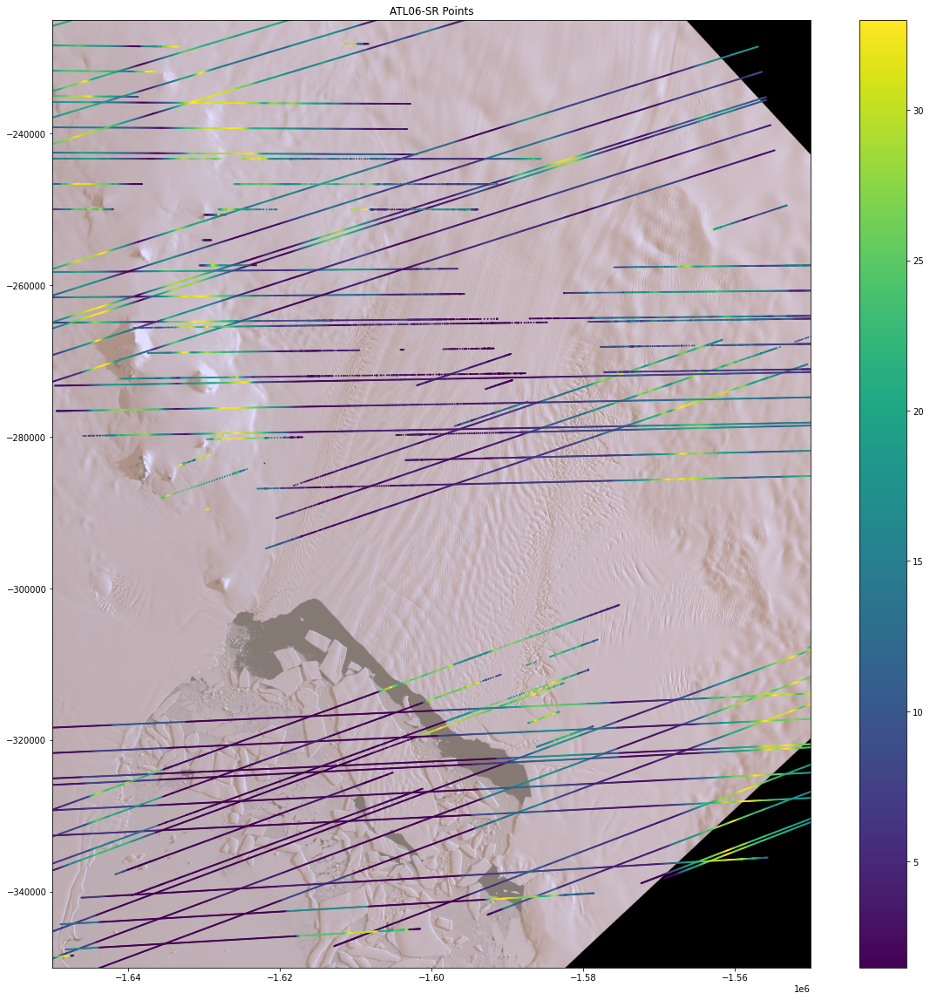

In [29]:
#plotting cycle 12 on pig

#open data
cycle = 12
with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/meta_df_cycle_'+str(cycle), 'rb') as handle:
    meta_df = pickle.load(handle)

# define path to landsat scene
scene = 'Landsat Imagery/LC08_L1GT_156131_20190112_20200830_02_T2'
exposure_percentile = 99.925

# plot the landsat imagery
ax = plot_landsat(scene,exposure_percentile)
    
# plot each line of roughness
for i in range(np.shape(meta_df)[0]):
    lines = ax.scatter(meta_df.at[i,'E_out'], meta_df.at[i,'N_out'], c=meta_df.at[i,'R'], s=1)#, vmin=-20, vmax=250)
#plt.colorbar(lines,ax=ax)

# add title
ax.set_title("ATL06-SR Points")

# limit the axes
ax.set_xlim([-1.65e6,-1.55e6])
ax.set_ylim([-3.5e5,-2.25e5])

plt.colorbar(lines,ax=ax)

# display plot
plt.show()

In [2]:
scene_list = [
    'Landsat Imagery/LC08_L1GT_156131_20181227_20200830_02_T2',
    'Landsat Imagery/LC08_L1GT_156131_20190112_20200830_02_T2',
    'Landsat Imagery/LC08_L1GT_233113_20201109_20210317_02_T2',
    'Landsat Imagery/LC08_L1GT_233113_20210128_20210305_02_T2'
]

In [ ]:
#plotting each individual cycle with chaanging imagery through time

x = 0
for i in range(1,12,3):
    #open data
    cycle = i
    with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/meta_df_cycle_'+str(cycle), 'rb') as handle:
        meta_df = pickle.load(handle)

    # define path to landsat scene
    scene = scene_list[x]
    x=x+1
    exposure_percentile = 99.925

    # plot the landsat imagery
    ax = plot_landsat(scene,exposure_percentile)
    
    # plot each line of roughness
    for i in range(np.shape(meta_df)[0]):
        lines = ax.scatter(meta_df.at[i,'E_out'], meta_df.at[i,'N_out'], c=meta_df.at[i,'R'], s=1, vmin=0, vmax=8)
    #plt.colorbar(lines,ax=ax)

    # add title
    ax.set_title("ATL06-SR Points")

    # limit the axes
    ax.set_xlim([-1.65e6,-1.55e6])
    ax.set_ylim([-3.5e5,-2.25e5])

    plt.savefig('pig_roughness_imagery_cycle_' + str(i),dpi=250)

100%|██████████| 69/69 [00:00<00:00, 179.35it/s]


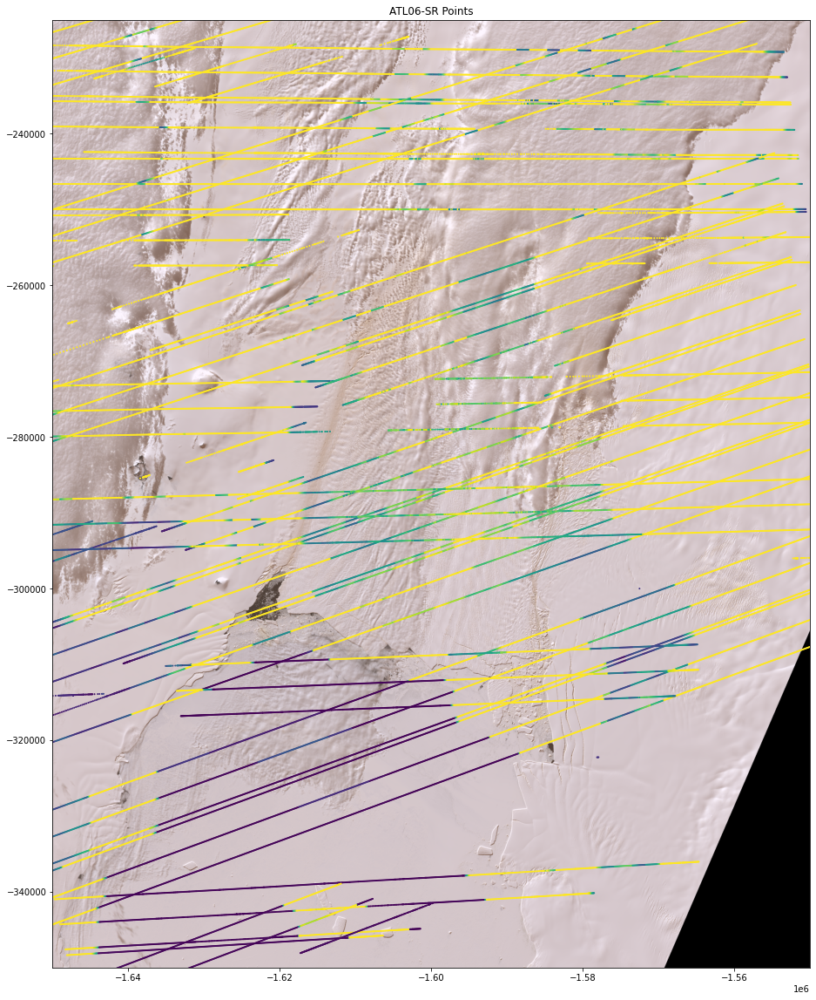

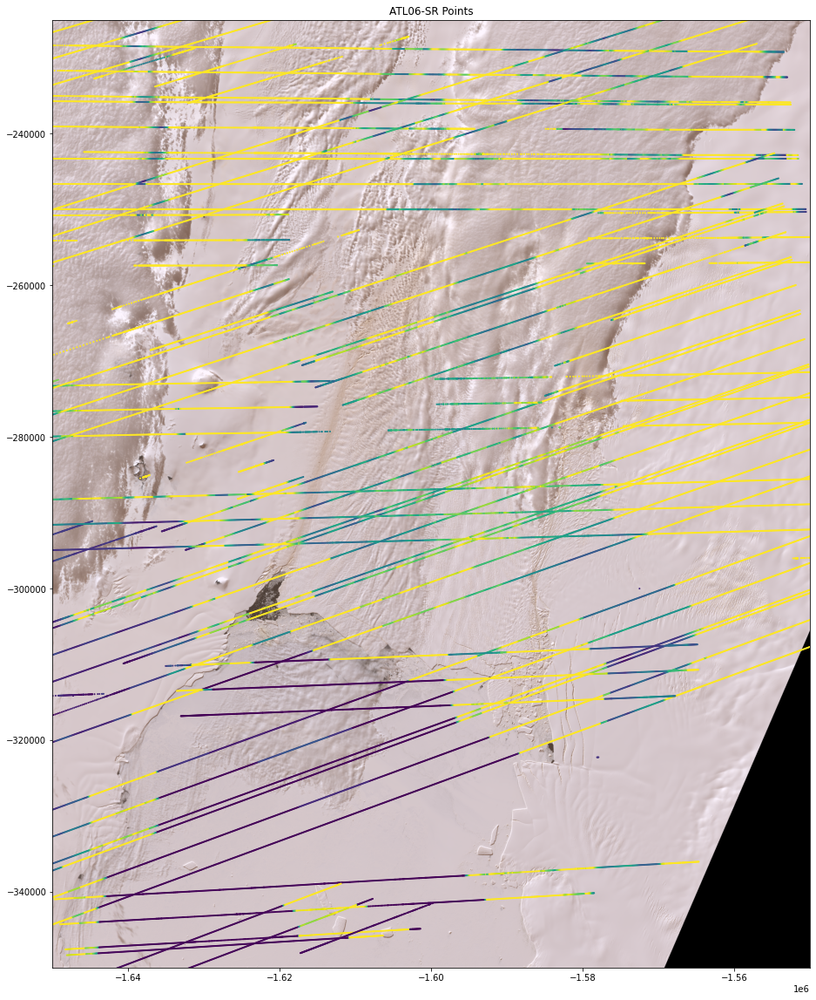

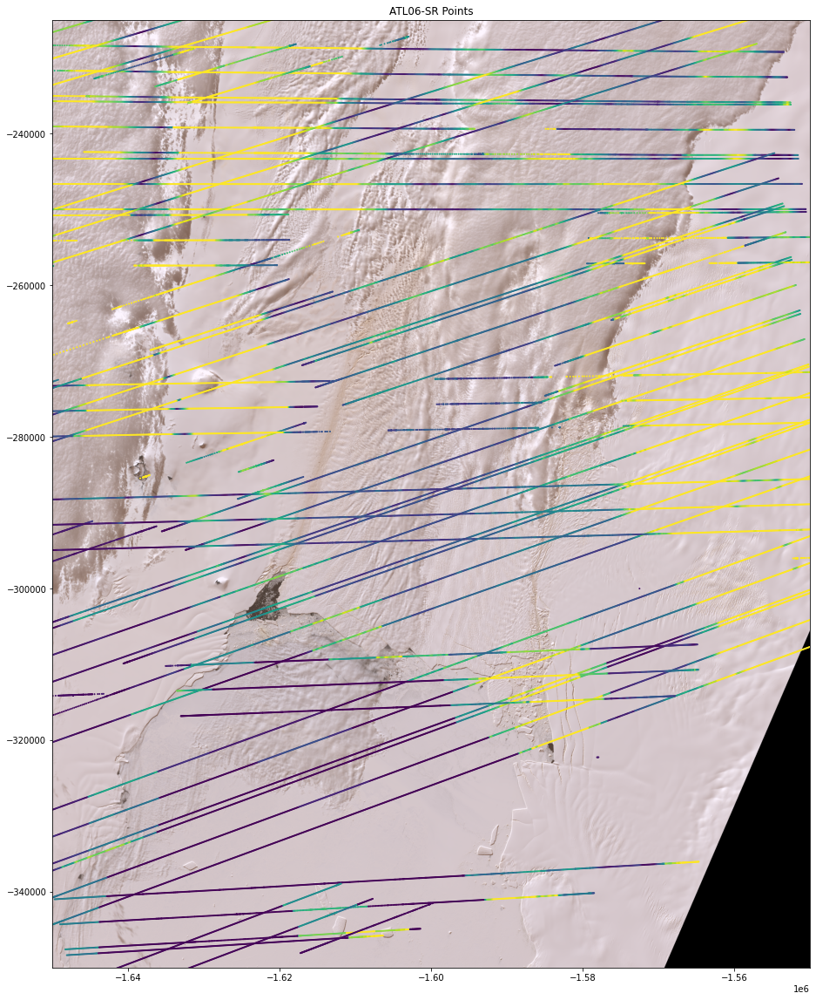

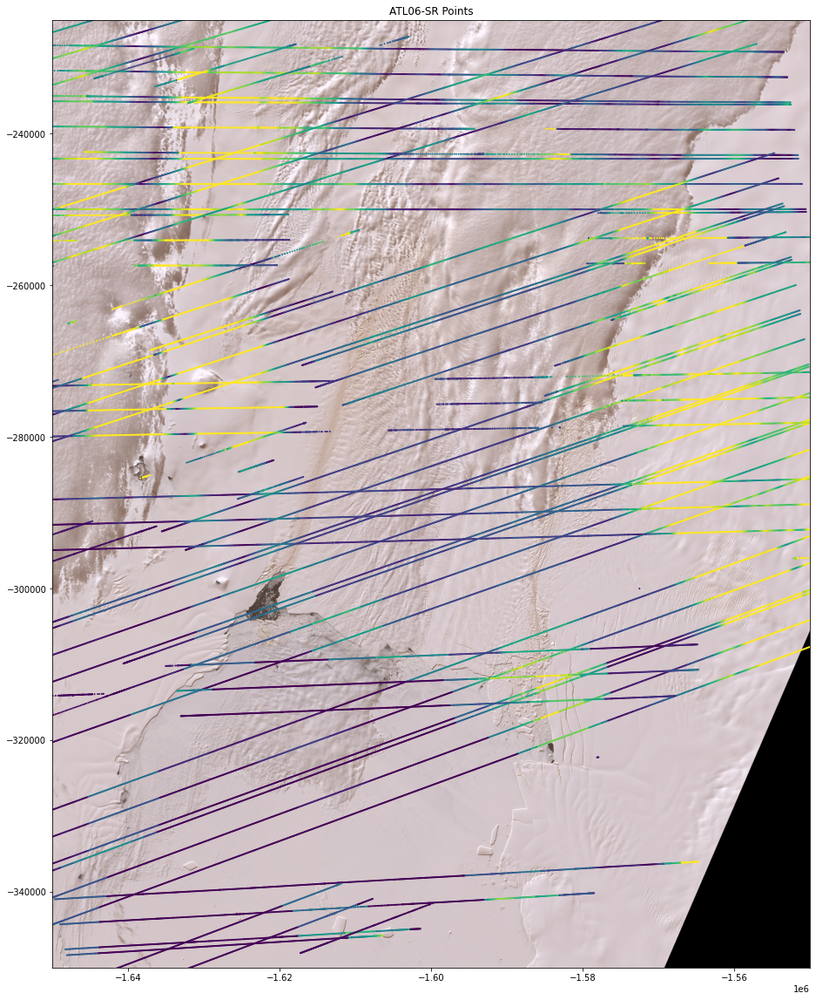

In [7]:
#plotting with changing integration bounds, one cycle

klims_dict = [[1/10000,1/90],[1/5000,1/90],[1/1000,1/90],[1/500,1/90]]

#iterate trough roughness calculation, changing integration bands
for i in range(len(klims_dict)):
    #open data
    with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/meta_df_klims_'+str(klims_dict[i]), 'rb') as handle:
        meta_df = pickle.load(handle)

    # define path to landsat scene
    scene = 'Landsat Imagery/LC08_L1GT_233113_20210128_20210305_02_T2'
    exposure_percentile = 99.925

    # plot the landsat imagery
    ax = plot_landsat(scene,exposure_percentile)
    
    # plot each line of roughness
    for j in tqdm.trange(np.shape(meta_df)[0]):
        lines = ax.scatter(meta_df.at[j,'E_out'], meta_df.at[j,'N_out'], c=meta_df.at[j,'R'], s=1, vmin=0, vmax=6)
    #plt.colorbar(lines,ax=ax)

    # add title
    ax.set_title("ATL06-SR Points")

    # limit the axes
    ax.set_xlim([-1.65e6,-1.55e6])
    ax.set_ylim([-3.5e5,-2.25e5])

    plt.savefig('pig_roughness_imagery_klims_' + str(klims_dict[i]) + '.png',dpi=250)

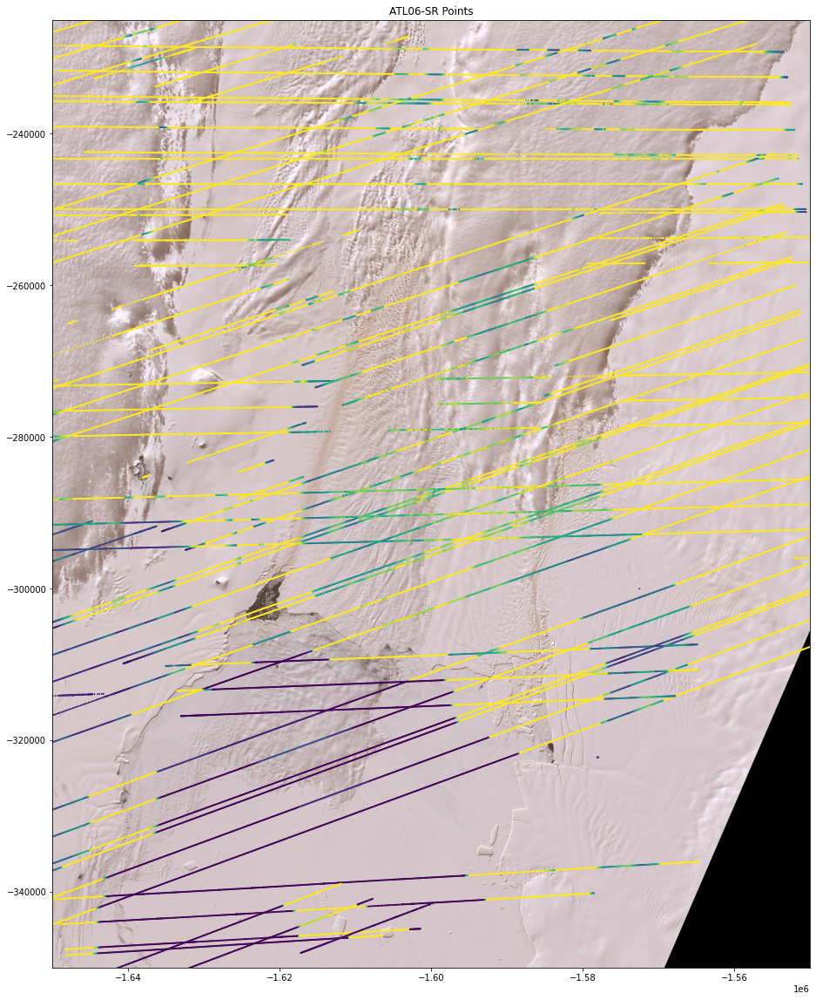

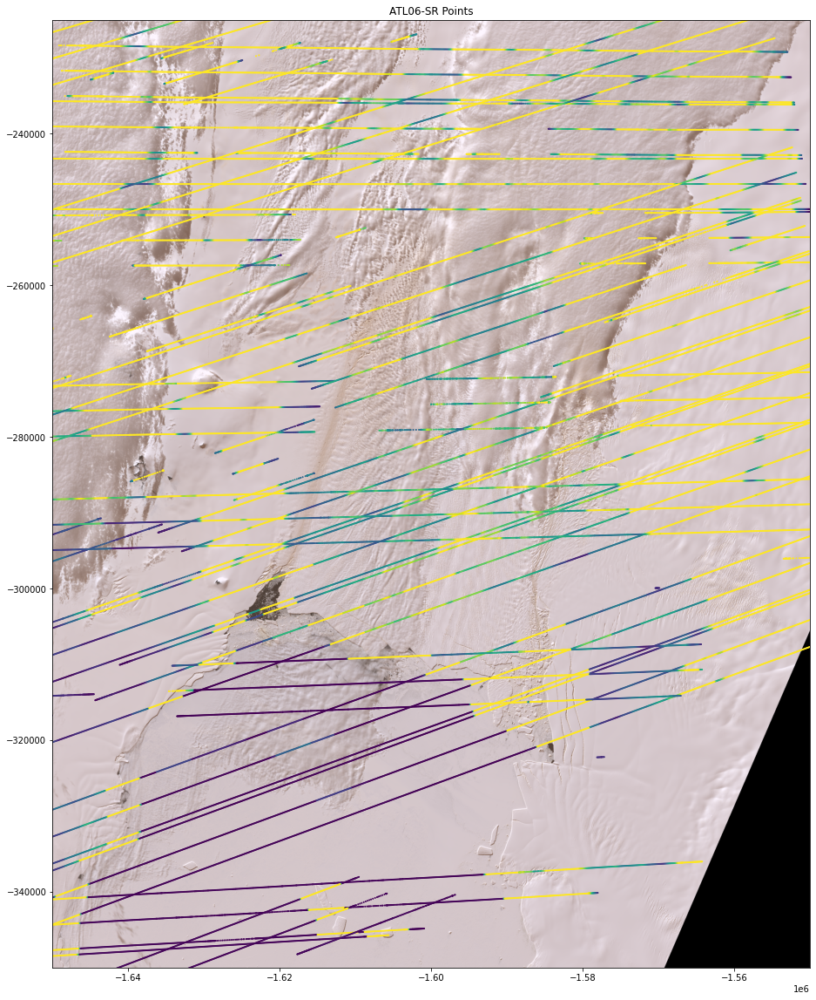

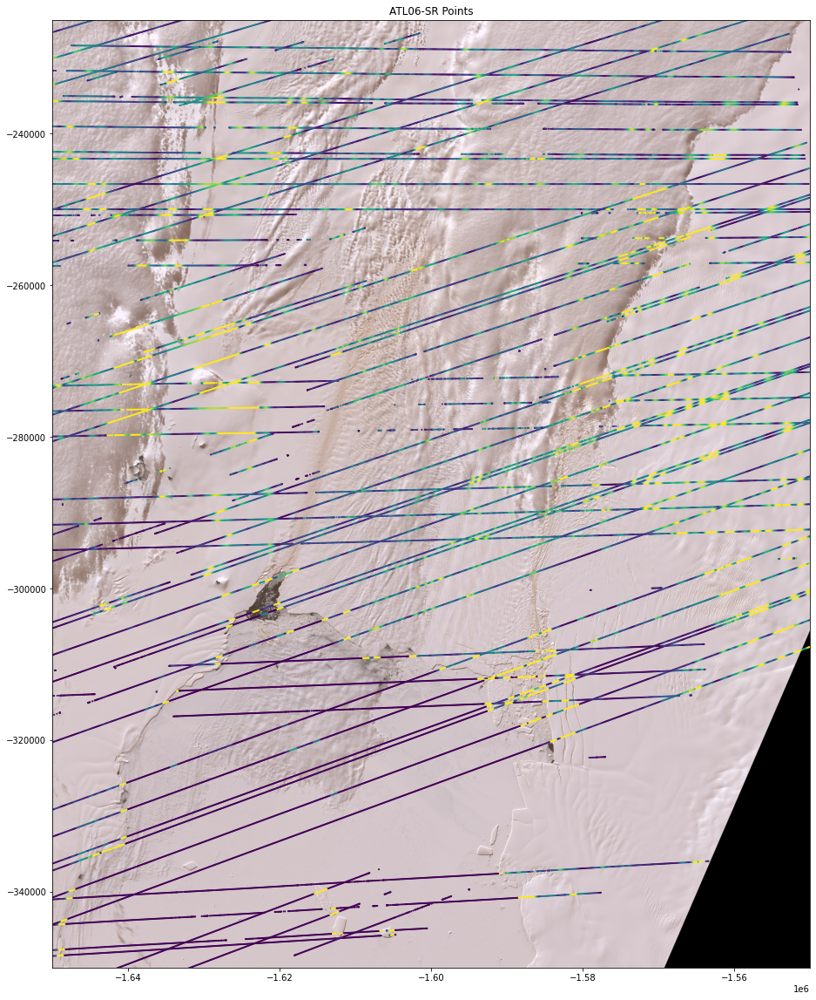

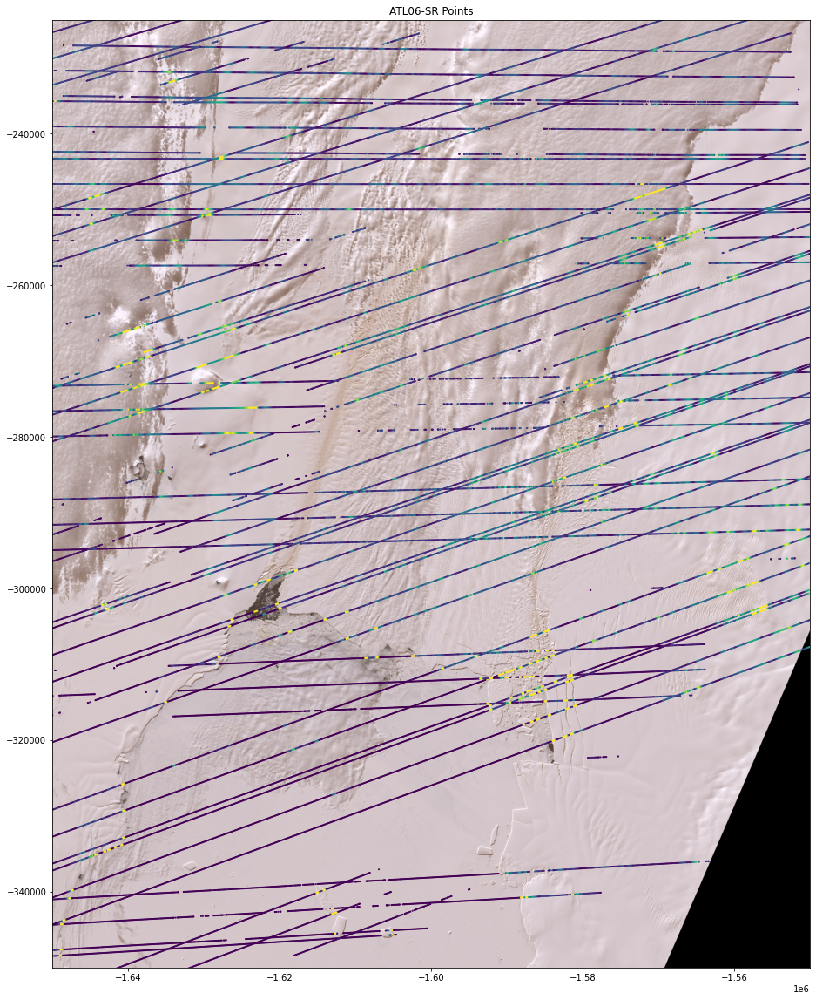

In [6]:
#plotting eith changing window size, one cycle

sz_dict = [10000,5000,1000,500]

#iterate trough roughness calculation, changing integration bands
for i in range(len(sz_dict)):
    #open data
    with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/meta_df_sz_'+str(sz_dict[i]), 'rb') as handle:
        meta_df = pickle.load(handle)

    # define path to landsat scene
    scene = 'Landsat Imagery/LC08_L1GT_233113_20210128_20210305_02_T2'
    exposure_percentile = 99.925

    # plot the landsat imagery
    ax = plot_landsat(scene,exposure_percentile)
    
    # plot each line of roughness
    for j in range(np.shape(meta_df)[0]):
        lines = ax.scatter(meta_df.at[j,'E_out'], meta_df.at[j,'N_out'], c=meta_df.at[j,'R'], s=1, vmin=0, vmax=6)
    #plt.colorbar(lines,ax=ax)

    # add title
    ax.set_title("ATL06-SR Points")

    # limit the axes
    ax.set_xlim([-1.65e6,-1.55e6])
    ax.set_ylim([-3.5e5,-2.25e5])

    plt.savefig('pig_roughness_imagery_sz_' + str(sz_dict[i]) + '.png',dpi=250)

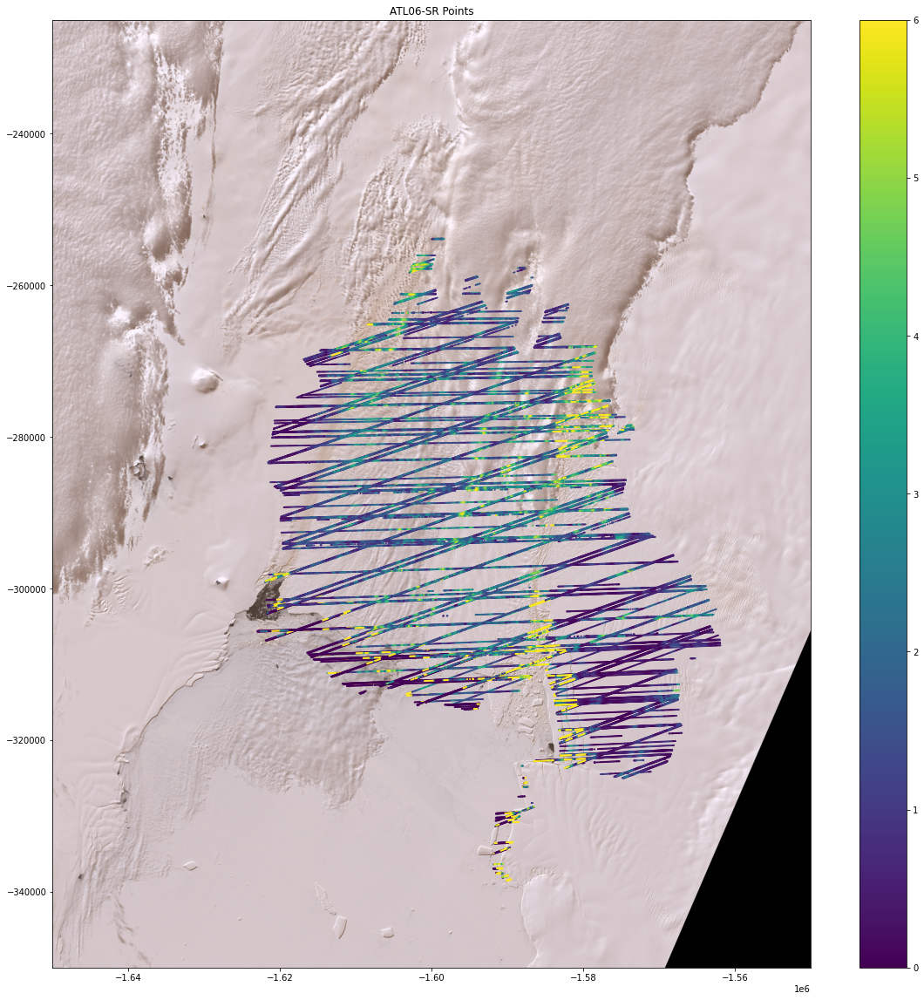

In [27]:
#plotting all cycles on pig with mask

#open data
with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/pig_full_df_cycle_all', 'rb') as handle:
    meta_df = pickle.load(handle)
    
study_shelf_id = 590802

all_shelf_outline_path = '/home/acdealy/notebooks/ice-shelf-roughness/shapefiles/USNIC_ANTARC_shelf_2022_epsg3031.shp'
all_shelf_outline = gpd.read_file(all_shelf_outline_path)
shape = all_shelf_outline[all_shelf_outline['OBJECTID']==study_shelf_id]    

#shape = gpd.read_file('/home/acdealy/notebooks/ice-shelf-roughness/shapefiles/USNIC_PIG_shelf_2022_epsg3031.shp')
    
# define path to landsat scene
scene = 'Landsat Imagery/LC08_L1GT_233113_20210128_20210305_02_T2'
exposure_percentile = 99.925

# plot the landsat imagery
ax = plot_landsat(scene,exposure_percentile)

# plot each line of roughness
for j in range(np.shape(meta_df)[0]):
    x = np.array(meta_df['E_out'].iloc[j])
    y = np.array(meta_df['N_out'].iloc[j])
    r = np.array(meta_df['R'].iloc[j])
    on_shelf = []
    for k in range(len(meta_df['E_out'].iloc[j])):
        pts_on_shelf = shape.contains(Point(x[k],y[k]))
        on_shelf.append(pts_on_shelf.values[0])
    on_shelf = np.array(on_shelf)
    x = x[on_shelf==True]
    y = y[on_shelf==True]
    r = r[on_shelf==True]
    lines = ax.scatter(x, y, c=r, s=1, vmin=0, vmax=6)

#add colorbar
plt.colorbar(lines,ax=ax)

# add title
ax.set_title("ATL06-SR Points")

# limit the axes
ax.set_xlim([-1.65e6,-1.55e6])
ax.set_ylim([-3.5e5,-2.25e5])

plt.savefig('pig_roughness_allcycles' + '.png',dpi=250)

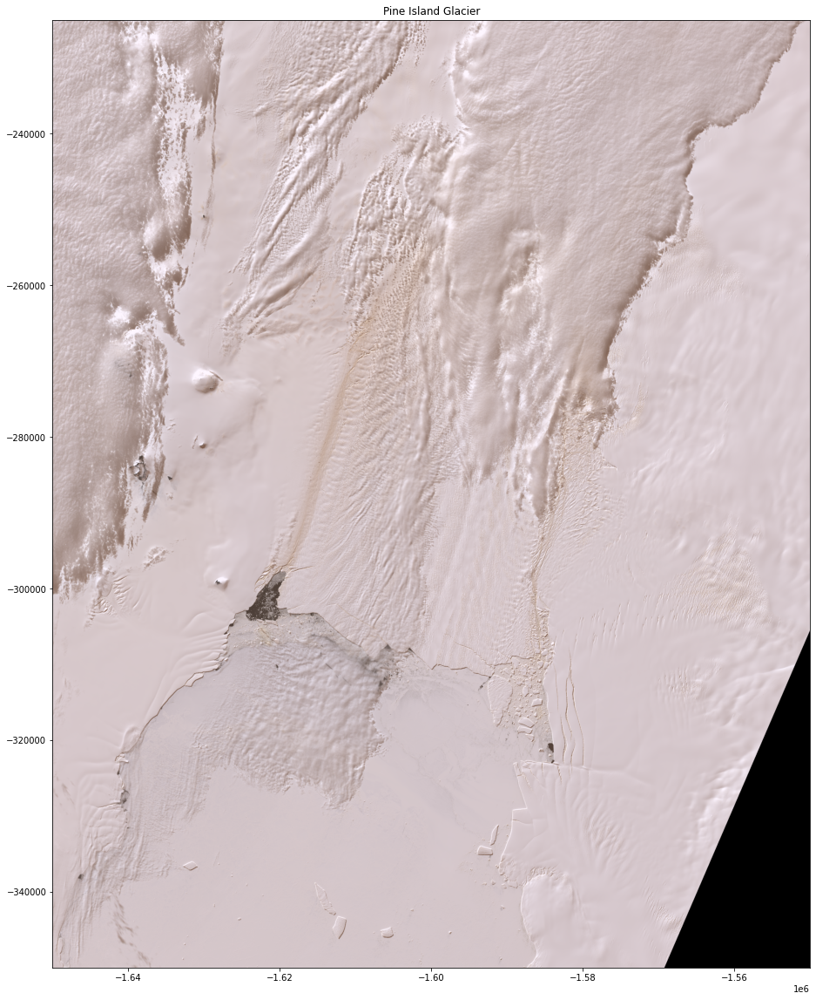

In [3]:
#plotting just pig imagery

# define path to landsat scene
scene = 'Landsat Imagery/LC08_L1GT_233113_20210128_20210305_02_T2'
exposure_percentile = 99.925

# plot the landsat imagery
ax = plot_landsat(scene,exposure_percentile)

# add title
ax.set_title("Pine Island Glacier")

# limit the axes
ax.set_xlim([-1.65e6,-1.55e6])
ax.set_ylim([-3.5e5,-2.25e5])

plt.savefig('pig_roughness_allcycles' + '.png',dpi=250)

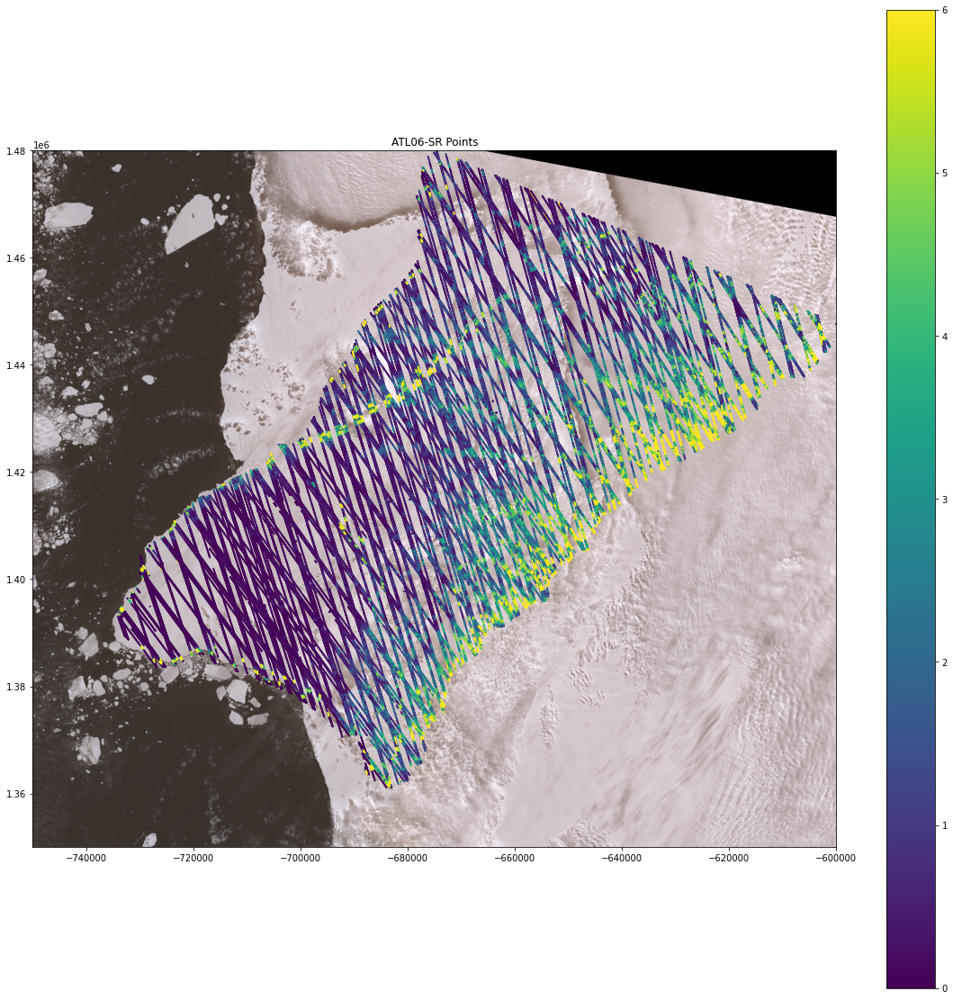

In [20]:
#plotting all cycles on brunt with mask

#open data and define shapefile
with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/brunt_df_cycle_all', 'rb') as handle:
    meta_df = pickle.load(handle)
shape = gpd.read_file('/home/acdealy/notebooks/ice-shelf-roughness/shapefiles/USNIC_brunt_shelf_2022_epsg3031.shp')

# define path to landsat scene
scene = 'LC08_L1GT_183114_20201229_20210310_02_T2'
exposure_percentile = 99.925

# plot the landsat imagery
ax = plot_landsat(scene,exposure_percentile)

# plot each line of roughness
for j in range(np.shape(meta_df)[0]):
    x = np.array(meta_df['E_out'].iloc[j])
    y = np.array(meta_df['N_out'].iloc[j])
    r = np.array(meta_df['R'].iloc[j])
    on_shelf = []
    for k in range(len(meta_df['E_out'].iloc[j])):
        pts_on_shelf = shape.contains(Point(x[k],y[k]))
        on_shelf.append(pts_on_shelf.values[0])
    on_shelf = np.array(on_shelf)
    x = x[on_shelf==True]
    y = y[on_shelf==True]
    r = r[on_shelf==True]
    lines = ax.scatter(x, y, c=r, s=1, vmin=0, vmax=6)

#add colorbar
plt.colorbar(lines,ax=ax)

# add title
ax.set_title("ATL06-SR Points")

# limit the axes
ax.set_xlim([-7.5e5,-6e5])
ax.set_ylim([1.35e6,1.48e6])

plt.savefig('pig_roughness_allcycles' + '.png',dpi=250)

(1350000.0, 1480000.0)

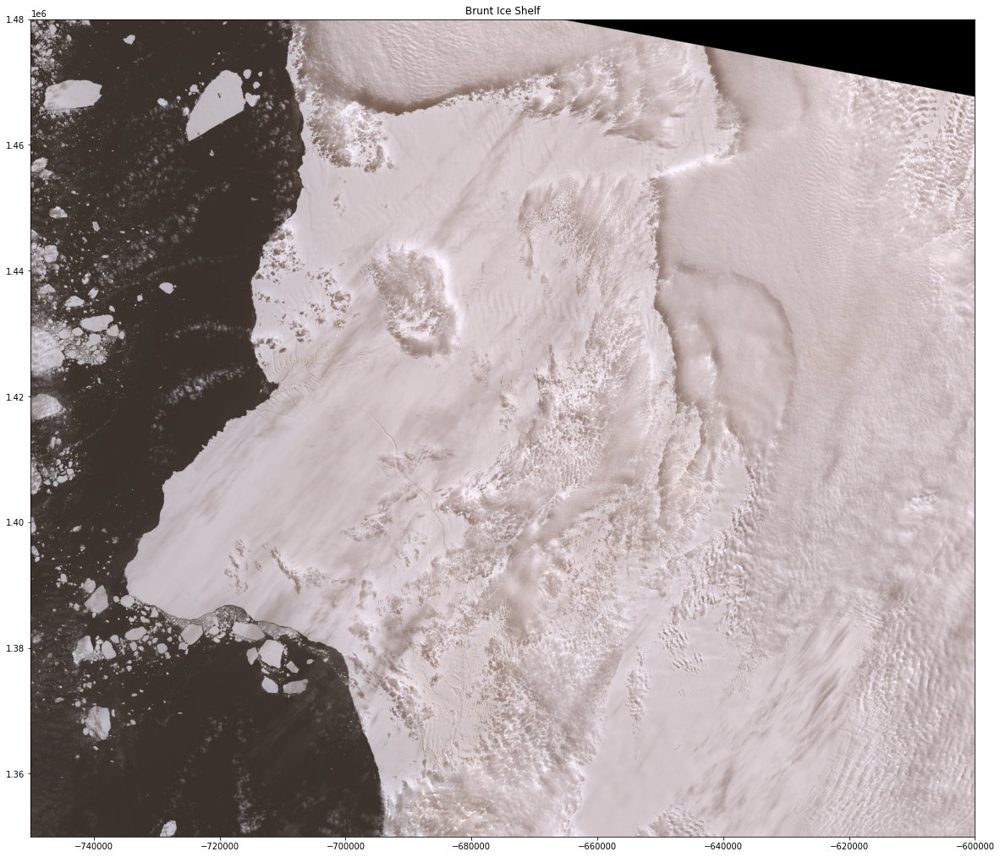

In [4]:
#plotting just imagery on brunt

# define path to landsat scene
scene = 'LC08_L1GT_183114_20201229_20210310_02_T2'
exposure_percentile = 99.925

# plot the landsat imagery
ax = plot_landsat(scene,exposure_percentile)

# add title
ax.set_title("Brunt Ice Shelf")

# limit the axes
ax.set_xlim([-7.5e5,-6e5])
ax.set_ylim([1.35e6,1.48e6])

100%|██████████| 854/854 [00:51<00:00, 16.57it/s]


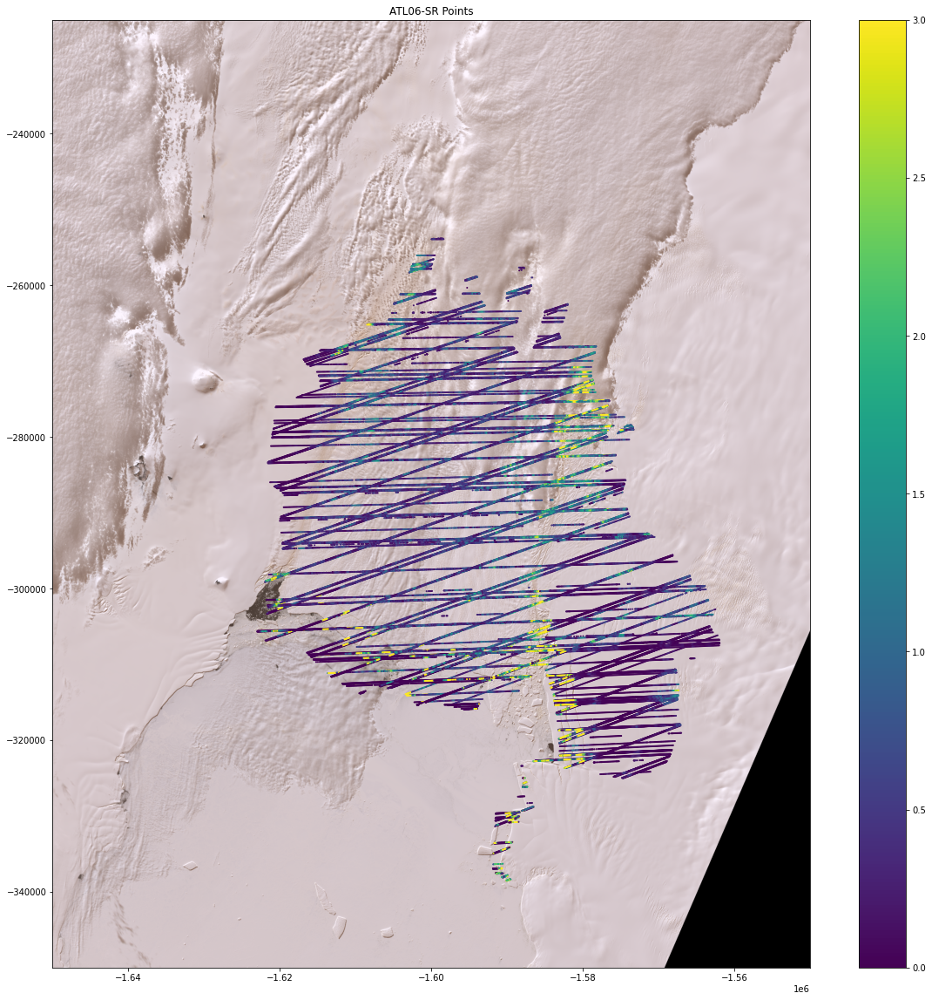

In [4]:
#plotting roughness with psd detrended on pig with mask

#open data
with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/pigdetrend_df_cycle_all', 'rb') as handle:
    meta_df = pickle.load(handle)
    
study_shelf_id = 590802

all_shelf_outline_path = '/home/acdealy/notebooks/ice-shelf-roughness/shapefiles/USNIC_ANTARC_shelf_2022_epsg3031.shp'
all_shelf_outline = gpd.read_file(all_shelf_outline_path)
shape = all_shelf_outline[all_shelf_outline['OBJECTID']==study_shelf_id]    

#shape = gpd.read_file('/home/acdealy/notebooks/ice-shelf-roughness/shapefiles/USNIC_PIG_shelf_2022_epsg3031.shp')
    
# define path to landsat scene
scene = 'Landsat Imagery/LC08_L1GT_233113_20210128_20210305_02_T2'
exposure_percentile = 99.925

# plot the landsat imagery
ax = plot_landsat(scene,exposure_percentile)

# plot each line of roughness
for j in tqdm.trange(np.shape(meta_df)[0]):
    x = np.array(meta_df['E_out'].iloc[j])
    y = np.array(meta_df['N_out'].iloc[j])
    r = np.array(meta_df['R'].iloc[j])
    on_shelf = []
    for k in range(len(meta_df['E_out'].iloc[j])):
        pts_on_shelf = shape.contains(Point(x[k],y[k]))
        on_shelf.append(pts_on_shelf.values[0])
    on_shelf = np.array(on_shelf)
    x = x[on_shelf==True]
    y = y[on_shelf==True]
    r = r[on_shelf==True]
    lines = ax.scatter(x, y, c=r, s=1, vmin=0, vmax=3)

#add colorbar
plt.colorbar(lines,ax=ax)

# add title
ax.set_title("ATL06-SR Points")

# limit the axes
ax.set_xlim([-1.65e6,-1.55e6])
ax.set_ylim([-3.5e5,-2.25e5])

plt.savefig('pig_roughness_allcycles_detrended' + '.png',dpi=250)

100%|██████████| 854/854 [00:01<00:00, 478.88it/s]


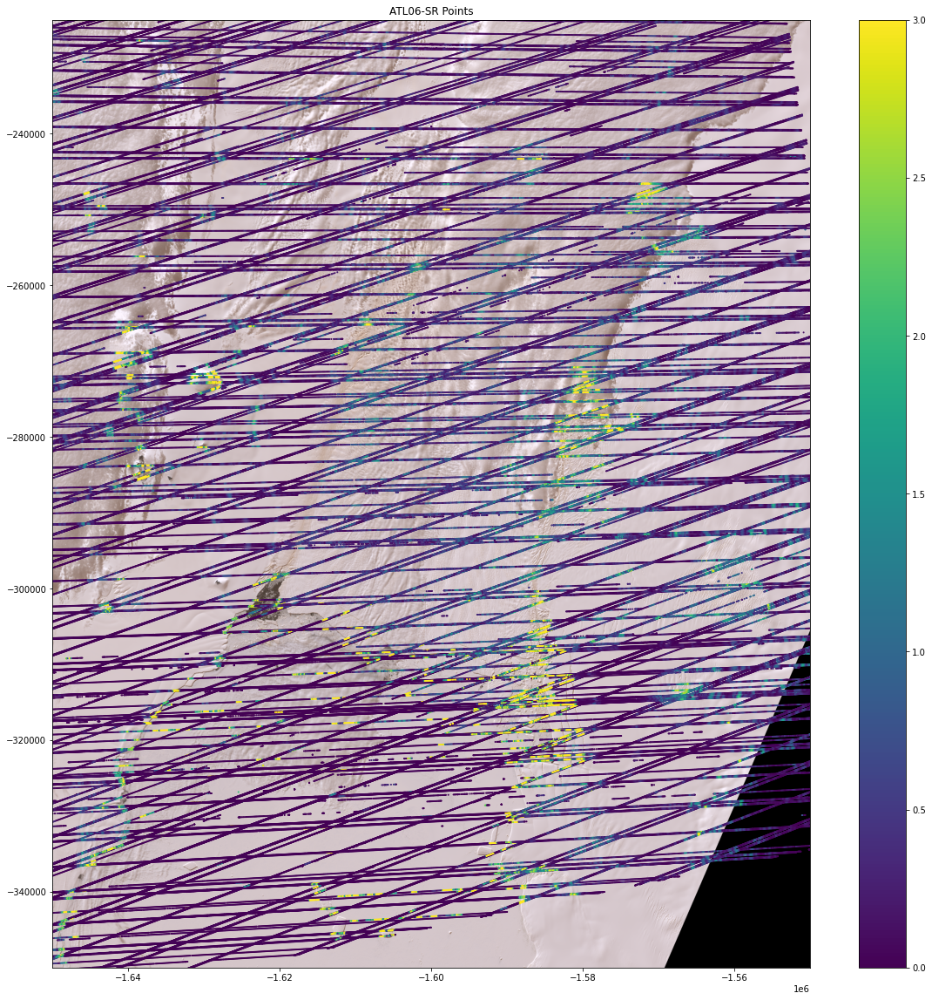

In [5]:
#plotting roughness with psd detrended on pig without mask

#open data
with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/pigdetrend_df_cycle_all', 'rb') as handle:
    meta_df = pickle.load(handle)
    
# define path to landsat scene
scene = 'Landsat Imagery/LC08_L1GT_233113_20210128_20210305_02_T2'
exposure_percentile = 99.925

# plot the landsat imagery
ax = plot_landsat(scene,exposure_percentile)

# plot each line of roughness
for j in tqdm.trange(np.shape(meta_df)[0]):
    x = np.array(meta_df['E_out'].iloc[j])
    y = np.array(meta_df['N_out'].iloc[j])
    r = np.array(meta_df['R'].iloc[j])
    lines = ax.scatter(x, y, c=r, s=1, vmin=0, vmax=3)

#add colorbar
plt.colorbar(lines,ax=ax)

# add title
ax.set_title("ATL06-SR Points")

# limit the axes
ax.set_xlim([-1.65e6,-1.55e6])
ax.set_ylim([-3.5e5,-2.25e5])

plt.savefig('pig_roughness_allcycles_detrended' + '.png',dpi=250)

100%|██████████| 1000/1000 [00:02<00:00, 466.01it/s]


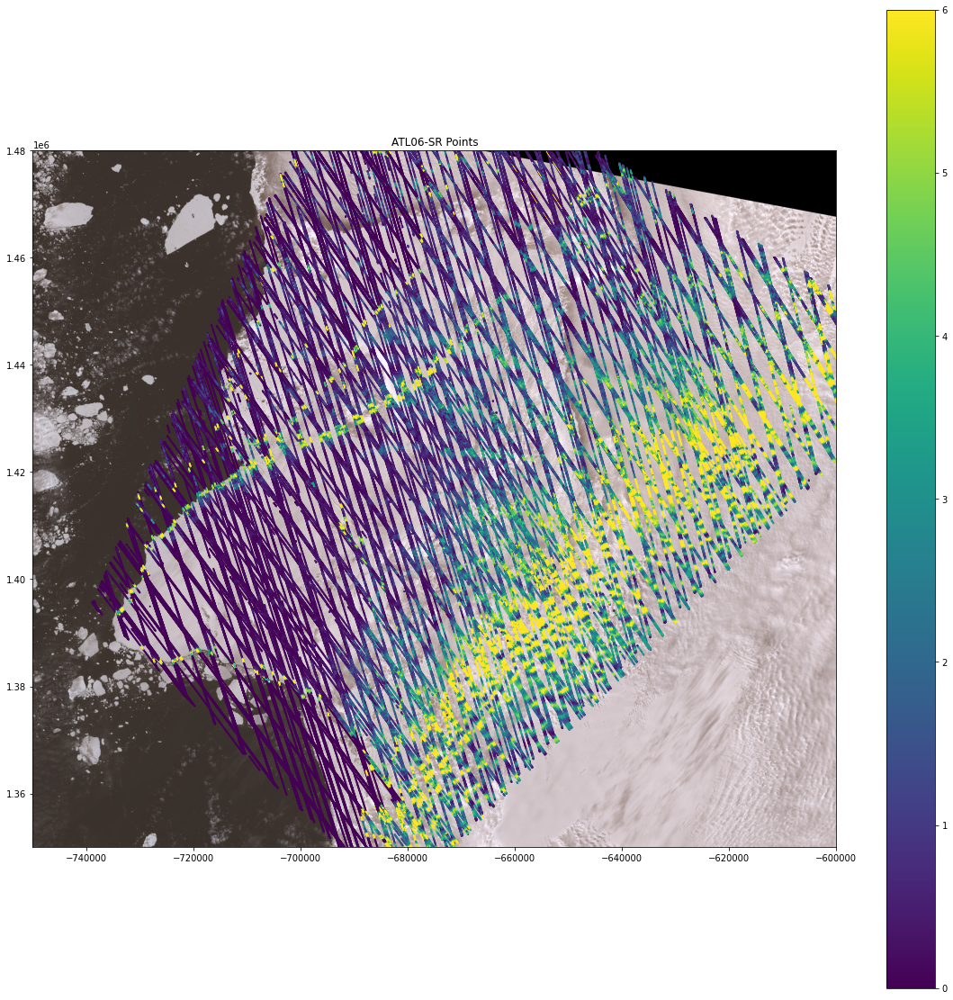

In [10]:
#plotting all cycles on brunt without mask

#open data and define shapefile
with open('/home/acdealy/notebooks/ice-shelf-roughness/outputs/brunt_df_cycle_all', 'rb') as handle:
    meta_df = pickle.load(handle)
shape = gpd.read_file('/home/acdealy/notebooks/ice-shelf-roughness/shapefiles/USNIC_brunt_shelf_2022_epsg3031.shp')

# plot the landsat imagery
scene = 'LC08_L1GT_183114_20201229_20210310_02_T2'
exposure_percentile = 99.925
ax = plot_landsat(scene,exposure_percentile)

# plot each line of roughness
for j in tqdm.trange(np.shape(meta_df)[0]):
    x = np.array(meta_df['E_out'].iloc[j])
    y = np.array(meta_df['N_out'].iloc[j])
    r = np.array(meta_df['R'].iloc[j])
    lines = ax.scatter(x, y, c=r, s=1, vmin=0, vmax=6)

#add colorbar
plt.colorbar(lines,ax=ax)

# add title
ax.set_title("ATL06-SR Points")

# limit the axes
ax.set_xlim([-7.5e5,-6e5])
ax.set_ylim([1.35e6,1.48e6])

plt.savefig('brunt_roughness_allcycles' + '.png',dpi=250)